# Siska Kumala
## Final Project
### sumber data: https://www.kaggle.com/rodsaldanha/arketing-campaign

content data:
AcceptedCmp1 - 1 if customer accepted the offer in the 1st campaign, 0 otherwise

AcceptedCmp2 - 1 if customer accepted the offer in the 2nd campaign, 0 otherwise

AcceptedCmp3 - 1 if customer accepted the offer in the 3rd campaign, 0 otherwise

AcceptedCmp4 - 1 if customer accepted the offer in the 4th campaign, 0 otherwise

AcceptedCmp5 - 1 if customer accepted the offer in the 5th campaign, 0 otherwise

Response (target) - 1 if customer accepted the offer in the last campaign, 0 otherwise

Complain - 1 if customer complained in the last 2 years

DtCustomer - date of customer’s enrolment with the company

Education - customer’s level of education

Marital - customer’s marital status

Kidhome - number of small children in customer’s household

 Teenhome - number of teenagers in customer’s household
 
 Income - customer’s yearly household income
 
MntFishProducts - amount spent on fish products in the last 2 years

MntMeatProducts - amount spent on meat products in the last 2 years

MntFruits - amount spent on fruits products in the last 2 years

MntSweetProducts - amount spent on sweet products in the last 2 years

MntWines - amount spent on wine products in the last 2 years

MntGoldProds - amount spent on gold products in the last 2 years

NumDealsPurchases - number of purchases made with discount

NumCatalogPurchases - number of purchases made using catalogue

NumStorePurchases - number of purchases made directly in stores

NumWebPurchases - number of purchases made through company’s web site

NumWebVisitsMonth - number of visits to company’s web site in the last month

Recency - number of days since the last purchase


Pada kasus ini, analis akan melihat model yang paling tepat untuk memprediksi apakah calon konsumer akan menerima campaign atau tidak

In [26]:
import numpy as np
import pandas as pd
%matplotlib inline
import matplotlib as mpl
import matplotlib.pyplot as plt
import seaborn as sns
import matplotlib.style as style
import math
import statistics
import scipy.stats
pd.set_option('display.max.columns',None)
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import classification_report,confusion_matrix
from sklearn.preprocessing import LabelEncoder
from sklearn.neighbors import KNeighborsClassifier
from sklearn.model_selection import train_test_split
from sklearn.naive_bayes import GaussianNB
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn import svm
import pandas_profiling

In [3]:
df = pd.read_csv('./Final/marketing_campaign.csv', delimiter=';')
df.head()

,ID,Year_Birth,Education,Marital_Status,Income,Kidhome,Teenhome,Dt_Customer,Recency,MntWines,MntFruits,MntMeatProducts,MntFishProducts,MntSweetProducts,MntGoldProds,NumDealsPurchases,NumWebPurchases,NumCatalogPurchases,NumStorePurchases,NumWebVisitsMonth,AcceptedCmp3,AcceptedCmp4,AcceptedCmp5,AcceptedCmp1,AcceptedCmp2,Complain,Z_CostContact,Z_Revenue,Response
0,5524,1957,Graduation,Single,58138.0,0,0,04/09/2012,58,635,88,546,172,88,88,3,8,10,4,7,0,0,0,0,0,0,3,11,1
1,2174,1954,Graduation,Single,46344.0,1,1,08/03/2014,38,11,1,6,2,1,6,2,1,1,2,5,0,0,0,0,0,0,3,11,0
2,4141,1965,Graduation,Together,71613.0,0,0,21/08/2013,26,426,49,127,111,21,42,1,8,2,10,4,0,0,0,0,0,0,3,11,0
3,6182,1984,Graduation,Together,26646.0,1,0,10/02/2014,26,11,4,20,10,3,5,2,2,0,4,6,0,0,0,0,0,0,3,11,0
4,5324,1981,PhD,Married,58293.0,1,0,19/01/2014,94,173,43,118,46,27,15,5,5,3,6,5,0,0,0,0,0,0,3,11,0


In [4]:
#menambahkan usia dan usia akun per id
df['Dt_Customer'] = pd.to_datetime(df['Dt_Customer'])
df['Dt_Customer_year_month'] = df['Dt_Customer'].dt.to_period("M")
df['account_age'] = (pd.to_datetime("2014-12").year - df['Dt_Customer_year_month'].dt.year)*12 + (pd.to_datetime("2014-12").month - df['Dt_Customer_year_month'].dt.month)
df['Age'] = 2014- df['Year_Birth']
df.head()

,ID,Year_Birth,Education,Marital_Status,Income,Kidhome,Teenhome,Dt_Customer,Recency,MntWines,MntFruits,MntMeatProducts,MntFishProducts,MntSweetProducts,MntGoldProds,NumDealsPurchases,NumWebPurchases,NumCatalogPurchases,NumStorePurchases,NumWebVisitsMonth,AcceptedCmp3,AcceptedCmp4,AcceptedCmp5,AcceptedCmp1,AcceptedCmp2,Complain,Z_CostContact,Z_Revenue,Response,Dt_Customer_year_month,account_age,Age
0,5524,1957,Graduation,Single,58138.0,0,0,2012-04-09,58,635,88,546,172,88,88,3,8,10,4,7,0,0,0,0,0,0,3,11,1,2012-04,32,57
1,2174,1954,Graduation,Single,46344.0,1,1,2014-08-03,38,11,1,6,2,1,6,2,1,1,2,5,0,0,0,0,0,0,3,11,0,2014-08,4,60
2,4141,1965,Graduation,Together,71613.0,0,0,2013-08-21,26,426,49,127,111,21,42,1,8,2,10,4,0,0,0,0,0,0,3,11,0,2013-08,16,49
3,6182,1984,Graduation,Together,26646.0,1,0,2014-10-02,26,11,4,20,10,3,5,2,2,0,4,6,0,0,0,0,0,0,3,11,0,2014-10,2,30
4,5324,1981,PhD,Married,58293.0,1,0,2014-01-19,94,173,43,118,46,27,15,5,5,3,6,5,0,0,0,0,0,0,3,11,0,2014-01,11,33


In [5]:
del df['Year_Birth']
del df ['Dt_Customer']
del df['Dt_Customer_year_month']
del df['Z_CostContact']
del df['Z_Revenue']
df.head()

,ID,Education,Marital_Status,Income,Kidhome,Teenhome,Recency,MntWines,MntFruits,MntMeatProducts,MntFishProducts,MntSweetProducts,MntGoldProds,NumDealsPurchases,NumWebPurchases,NumCatalogPurchases,NumStorePurchases,NumWebVisitsMonth,AcceptedCmp3,AcceptedCmp4,AcceptedCmp5,AcceptedCmp1,AcceptedCmp2,Complain,Response,account_age,Age
0,5524,Graduation,Single,58138.0,0,0,58,635,88,546,172,88,88,3,8,10,4,7,0,0,0,0,0,0,1,32,57
1,2174,Graduation,Single,46344.0,1,1,38,11,1,6,2,1,6,2,1,1,2,5,0,0,0,0,0,0,0,4,60
2,4141,Graduation,Together,71613.0,0,0,26,426,49,127,111,21,42,1,8,2,10,4,0,0,0,0,0,0,0,16,49
3,6182,Graduation,Together,26646.0,1,0,26,11,4,20,10,3,5,2,2,0,4,6,0,0,0,0,0,0,0,2,30
4,5324,PhD,Married,58293.0,1,0,94,173,43,118,46,27,15,5,5,3,6,5,0,0,0,0,0,0,0,11,33


In [6]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2240 entries, 0 to 2239
Data columns (total 27 columns):
 #   Column               Non-Null Count  Dtype  
---  ------               --------------  -----  
 0   ID                   2240 non-null   int64  
 1   Education            2240 non-null   object 
 2   Marital_Status       2240 non-null   object 
 3   Income               2216 non-null   float64
 4   Kidhome              2240 non-null   int64  
 5   Teenhome             2240 non-null   int64  
 6   Recency              2240 non-null   int64  
 7   MntWines             2240 non-null   int64  
 8   MntFruits            2240 non-null   int64  
 9   MntMeatProducts      2240 non-null   int64  
 10  MntFishProducts      2240 non-null   int64  
 11  MntSweetProducts     2240 non-null   int64  
 12  MntGoldProds         2240 non-null   int64  
 13  NumDealsPurchases    2240 non-null   int64  
 14  NumWebPurchases      2240 non-null   int64  
 15  NumCatalogPurchases  2240 non-null   i

In [7]:
#untuk melihat berbagai jenis kelompok data 
print('Column name')
for col in df.columns:
    if df[col].dtype=='object':
        print(col, df[col].nunique())

Column name
Education 5
Marital_Status 8


Terdapat 5 jenis 'education' pada data, dan 8 jenis 'marital status'.


In [8]:
#untuk mengetahui apakah terdapat missing value pada data
missing = df.isnull().sum()/len(df)*100

print(pd.DataFrame([missing[missing>0],pd.Series(df.isnull().sum()[df.isnull().sum()>1000])], index=['percent missing','how many missing']))

                    Income
percent missing   1.071429
how many missing       NaN


karena ada missing value dan jumlah data yang missing sangat kecil, maka data yang hilang di drop

In [9]:
df.dropna(inplace = True)

In [10]:
df.shape

(2216, 27)

Setelah di drop, data tinggal 2216 row dari sebelumnya 2240

In [11]:
#Untuk mengetahui apakah terdapat duplikasi pada data
print('Duplikasi: ',sum(df.duplicated()))
#print(sum(df.duplicated()))

Duplikasi:  0


In [12]:
#untuk melihat outlier
for i in df:
    print(df[i].value_counts(),'\n')

0        1
3479     1
2694     1
4743     1
10888    1
        ..
202      1
5376     1
4552     1
7419     1
4094     1
Name: ID, Length: 2216, dtype: int64 

Graduation    1116
PhD            481
Master         365
2n Cycle       200
Basic           54
Name: Education, dtype: int64 

Married     857
Together    573
Single      471
Divorced    232
Widow        76
Alone         3
Absurd        2
YOLO          2
Name: Marital_Status, dtype: int64 

7500.0     12
35860.0     4
18929.0     3
34176.0     3
67445.0     3
           ..
83033.0     1
29999.0     1
65819.0     1
54132.0     1
62335.0     1
Name: Income, Length: 1974, dtype: int64 

0    1283
1     887
2      46
Name: Kidhome, dtype: int64 

0    1147
1    1018
2      51
Name: Teenhome, dtype: int64 

56    37
54    32
30    32
46    31
92    30
      ..
58    15
59    14
22    13
7     12
44    11
Name: Recency, Length: 100, dtype: int64 

2       42
6       37
5       37
1       37
4       33
        ..
948      1
944      1


pada data terdapat sekilas terdapat outlier pada 'marital_status' yaitu Alone, Absurd, and Yolo, namun demikian karena status married secara umum hanya ada 4, maka Alone, Absurd, Yolo diganti dengan Single, sehingga data ini tidak outlier


In [13]:
df['Marital_Status'].value_counts()

Married     857
Together    573
Single      471
Divorced    232
Widow        76
Alone         3
Absurd        2
YOLO          2
Name: Marital_Status, dtype: int64

In [14]:
#menggangti data outlier dengan pendekatan status yg mirip lainnya dan merubah object menjadi int
df['Marital_Status'] = df['Marital_Status'].replace(['YOLO', 'Alone', 'Absurd','Single'], 1)
df['Marital_Status'] = df['Marital_Status'].replace(['Divorced'], 2)
df['Marital_Status'] = df['Marital_Status'].replace(['Widow'], 3)
df['Marital_Status'] = df['Marital_Status'].replace(['Together'], 4)
df['Marital_Status'] = df['Marital_Status'].replace(['Married'], 5)

In [15]:
df['Marital_Status'].value_counts()

5    857
4    573
1    478
2    232
3     76
Name: Marital_Status, dtype: int64

In [16]:
df['Education'].value_counts()

Graduation    1116
PhD            481
Master         365
2n Cycle       200
Basic           54
Name: Education, dtype: int64

In [17]:
df['Education'] = df['Education'].replace(['Basic'], 1)
df['Education'] = df['Education'].replace(['2n Cycle'], 2)
df['Education'] = df['Education'].replace(['Graduation'], 3)
df['Education'] = df['Education'].replace(['Master'], 4)
df['Education'] = df['Education'].replace(['PhD'], 5)


In [18]:
df['Education'].value_counts()

3    1116
5     481
4     365
2     200
1      54
Name: Education, dtype: int64

In [19]:
df.head()

,ID,Education,Marital_Status,Income,Kidhome,Teenhome,Recency,MntWines,MntFruits,MntMeatProducts,MntFishProducts,MntSweetProducts,MntGoldProds,NumDealsPurchases,NumWebPurchases,NumCatalogPurchases,NumStorePurchases,NumWebVisitsMonth,AcceptedCmp3,AcceptedCmp4,AcceptedCmp5,AcceptedCmp1,AcceptedCmp2,Complain,Response,account_age,Age
0,5524,3,1,58138.0,0,0,58,635,88,546,172,88,88,3,8,10,4,7,0,0,0,0,0,0,1,32,57
1,2174,3,1,46344.0,1,1,38,11,1,6,2,1,6,2,1,1,2,5,0,0,0,0,0,0,0,4,60
2,4141,3,4,71613.0,0,0,26,426,49,127,111,21,42,1,8,2,10,4,0,0,0,0,0,0,0,16,49
3,6182,3,4,26646.0,1,0,26,11,4,20,10,3,5,2,2,0,4,6,0,0,0,0,0,0,0,2,30
4,5324,5,5,58293.0,1,0,94,173,43,118,46,27,15,5,5,3,6,5,0,0,0,0,0,0,0,11,33


In [20]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 2216 entries, 0 to 2239
Data columns (total 27 columns):
 #   Column               Non-Null Count  Dtype  
---  ------               --------------  -----  
 0   ID                   2216 non-null   int64  
 1   Education            2216 non-null   int64  
 2   Marital_Status       2216 non-null   int64  
 3   Income               2216 non-null   float64
 4   Kidhome              2216 non-null   int64  
 5   Teenhome             2216 non-null   int64  
 6   Recency              2216 non-null   int64  
 7   MntWines             2216 non-null   int64  
 8   MntFruits            2216 non-null   int64  
 9   MntMeatProducts      2216 non-null   int64  
 10  MntFishProducts      2216 non-null   int64  
 11  MntSweetProducts     2216 non-null   int64  
 12  MntGoldProds         2216 non-null   int64  
 13  NumDealsPurchases    2216 non-null   int64  
 14  NumWebPurchases      2216 non-null   int64  
 15  NumCatalogPurchases  2216 non-null   i

In [21]:
df['Education'] = pd.to_numeric(df['Education'])
df['Marital_Status'] = pd.to_numeric(df['Marital_Status'])

In [22]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 2216 entries, 0 to 2239
Data columns (total 27 columns):
 #   Column               Non-Null Count  Dtype  
---  ------               --------------  -----  
 0   ID                   2216 non-null   int64  
 1   Education            2216 non-null   int64  
 2   Marital_Status       2216 non-null   int64  
 3   Income               2216 non-null   float64
 4   Kidhome              2216 non-null   int64  
 5   Teenhome             2216 non-null   int64  
 6   Recency              2216 non-null   int64  
 7   MntWines             2216 non-null   int64  
 8   MntFruits            2216 non-null   int64  
 9   MntMeatProducts      2216 non-null   int64  
 10  MntFishProducts      2216 non-null   int64  
 11  MntSweetProducts     2216 non-null   int64  
 12  MntGoldProds         2216 non-null   int64  
 13  NumDealsPurchases    2216 non-null   int64  
 14  NumWebPurchases      2216 non-null   int64  
 15  NumCatalogPurchases  2216 non-null   i

In [23]:
df.describe()

,ID,Education,Marital_Status,Income,Kidhome,Teenhome,Recency,MntWines,MntFruits,MntMeatProducts,...,NumWebVisitsMonth,AcceptedCmp3,AcceptedCmp4,AcceptedCmp5,AcceptedCmp1,AcceptedCmp2,Complain,Response,account_age,Age
count,2216.000000,2216.000000,2216.000000,2216.000000,2216.000000,2216.000000,2216.000000,2216.000000,2216.000000,2216.000000,...,2216.000000,2216.000000,2216.000000,2216.000000,2216.000000,2216.000000,2216.000000,2216.000000,2216.000000,2216.000000
mean,5588.353339,3.459838,3.495939,52247.251354,0.441787,0.505415,49.012635,305.091606,26.356047,166.995939,...,5.319043,0.073556,0.074007,0.073105,0.064079,0.013538,0.009477,0.150271,17.141697,45.179603
std,3249.376275,1.004825,1.590032,25173.076661,0.536896,0.544181,28.948352,337.327920,39.793917,224.283273,...,2.425359,0.261106,0.261842,0.260367,0.244950,0.115588,0.096907,0.357417,7.667984,11.985554
min,0.000000,1.000000,1.000000,1730.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,18.000000
25%,2814.750000,3.000000,2.000000,35303.000000,0.000000,0.000000,24.000000,24.000000,2.000000,16.000000,...,3.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,12.000000,37.000000
50%,5458.500000,3.000000,4.000000,51381.500000,0.000000,0.000000,49.000000,174.500000,8.000000,68.000000,...,6.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,17.000000,44.000000
75%,8421.750000,4.000000,5.000000,68522.000000,1.000000,1.000000,74.000000,505.000000,33.000000,232.250000,...,7.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,23.000000,55.000000
max,11191.000000,5.000000,5.000000,666666.000000,2.000000,2.000000,99.000000,1493.000000,199.000000,1725.000000,...,20.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,35.000000,121.000000


In [28]:
df.columns.values

array(['ID', 'Education', 'Marital_Status', 'Income', 'Kidhome',
       'Teenhome', 'Recency', 'MntWines', 'MntFruits', 'MntMeatProducts',
       'MntFishProducts', 'MntSweetProducts', 'MntGoldProds',
       'NumDealsPurchases', 'NumWebPurchases', 'NumCatalogPurchases',
       'NumStorePurchases', 'NumWebVisitsMonth', 'AcceptedCmp3',
       'AcceptedCmp4', 'AcceptedCmp5', 'AcceptedCmp1', 'AcceptedCmp2',
       'Complain', 'Response', 'account_age', 'Age'], dtype=object)

In [29]:
numeric_columns = ['Education', 'Marital_Status', 'Income', 'Kidhome',
       'Teenhome', 'Recency', 'MntWines', 'MntFruits', 'MntMeatProducts',
       'MntFishProducts', 'MntSweetProducts', 'MntGoldProds',
       'NumDealsPurchases', 'NumWebPurchases', 'NumCatalogPurchases',
       'NumStorePurchases', 'NumWebVisitsMonth', 'AcceptedCmp3',
       'AcceptedCmp4', 'AcceptedCmp5', 'AcceptedCmp1', 'AcceptedCmp2',
       'Complain', 'Response', 'account_age', 'Age']



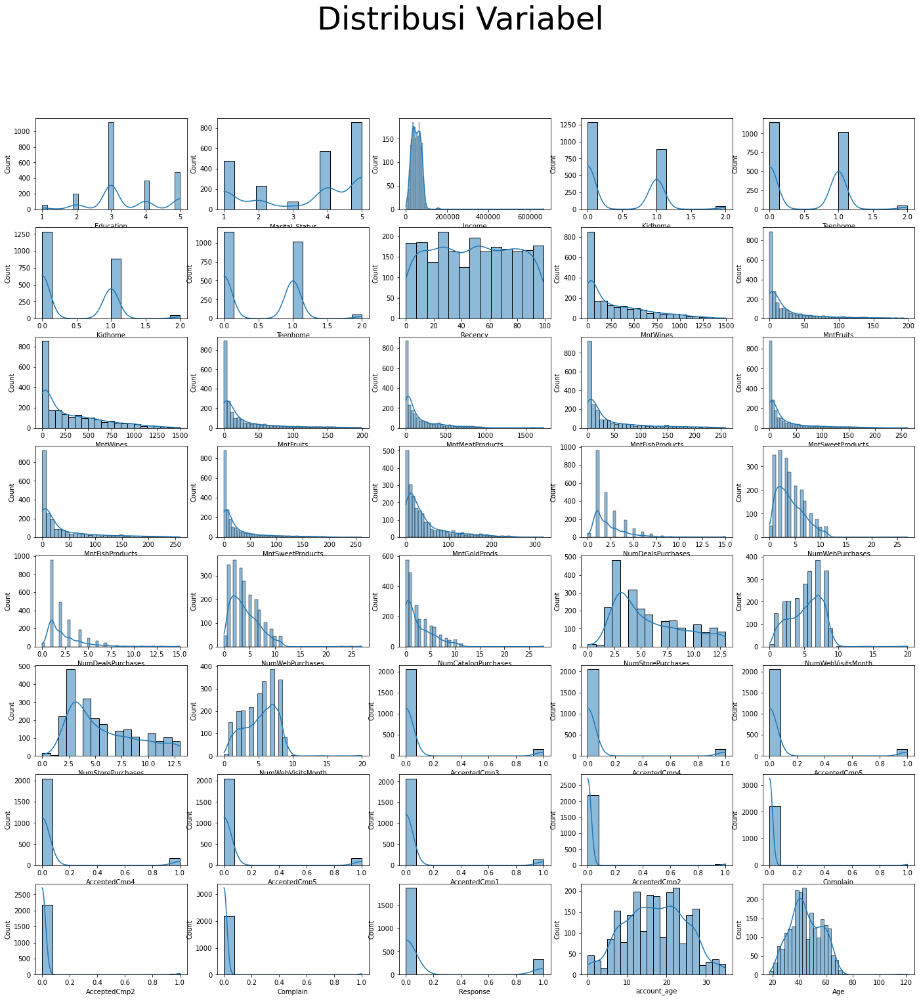

In [41]:
fig, axes = plt.subplots(8,5, figsize=(24,24))
fig.suptitle("Distribusi Variabel", size=48)

for i in range(8):
    for j in range(5):
        sns.histplot(df[numeric_columns[3*i+j]], ax=axes[i,j], kde=True)

Pie Chart untuk Kolom Kategori:



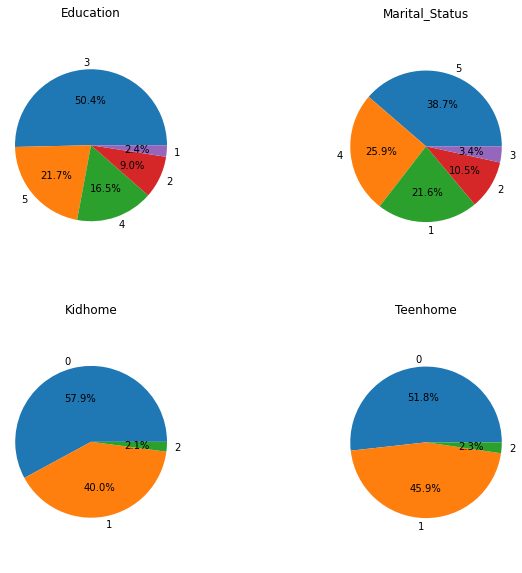

In [43]:
print('Pie Chart untuk Kolom Kategori:')
print('================================')
print('')

plt.figure(figsize=(15,10))

plt.subplot(2,3,1)
df_edu = df['Education'].value_counts()
df_edu.plot(kind='pie',autopct='%1.1f%%',labels=df_edu.index)
plt.axis('equal')
plt.ylabel('')
plt.title('Education')

plt.subplot(2,3,2)
df_mar = df['Marital_Status'].value_counts()
df_mar.plot(kind='pie',autopct='%1.1f%%',labels=df_mar.index)
plt.axis('equal')
plt.ylabel('')
plt.title('Marital_Status')

plt.subplot(2,3,4)
df_kid = df['Kidhome'].value_counts()
df_kid.plot(kind='pie',autopct='%1.1f%%',labels=df_kid.index)
plt.axis('equal')
plt.ylabel('')
plt.title('Kidhome')


plt.subplot(2,3,5)
df_teen = df['Teenhome'].value_counts()
df_teen.plot(kind='pie',autopct='%1.1f%%',labels=df_teen.index)
plt.axis('equal')
plt.ylabel('')
plt.title('Teenhome')





plt.subplots_adjust(wspace=1)
plt.show()

In [53]:
#melihat corelasi dalam 
df.corr()

,ID,Education,Marital_Status,Income,Kidhome,Teenhome,Recency,MntWines,MntFruits,MntMeatProducts,...,NumWebVisitsMonth,AcceptedCmp3,AcceptedCmp4,AcceptedCmp5,AcceptedCmp1,AcceptedCmp2,Complain,Response,account_age,Age
ID,1.000000,-0.003574,0.021518,0.013095,0.001736,-0.003030,-0.044376,-0.021084,0.007326,-0.005902,...,-0.007794,-0.035890,-0.023933,-0.007064,-0.018219,-0.014994,0.034154,-0.021491,-0.007736,-0.002355
Education,-0.003574,1.000000,0.005267,0.149338,-0.053710,0.137042,-0.013858,0.215037,-0.076176,0.048746,...,-0.055965,0.003521,0.062780,0.035387,-0.002379,0.024119,-0.044772,0.099150,-0.072797,0.184809
Marital_Status,0.021518,0.005267,1.000000,0.007957,0.009771,0.052463,-0.006374,0.001477,-0.020038,-0.029070,...,0.004141,-0.017223,0.002891,0.020347,0.013419,-0.009526,-0.010005,-0.139139,0.002343,0.033180
Income,0.013095,0.149338,0.007957,1.000000,-0.428669,0.019133,-0.003970,0.578650,0.430842,0.584633,...,-0.553088,-0.016174,0.184400,0.335943,0.276820,0.087545,-0.027225,0.133047,-0.017733,0.161791
Kidhome,0.001736,-0.053710,0.009771,-0.428669,1.000000,-0.039869,0.011492,-0.497336,-0.373396,-0.439261,...,0.447477,0.016066,-0.162026,-0.205305,-0.174163,-0.081868,0.040978,-0.077909,-0.057103,-0.233615
Teenhome,-0.003030,0.137042,0.052463,0.019133,-0.039869,1.000000,0.013838,0.003747,-0.176558,-0.261122,...,0.131240,-0.042522,0.038376,-0.190791,-0.144855,-0.015521,0.003307,-0.153901,0.008255,0.350791
Recency,-0.044376,-0.013858,-0.006374,-0.003970,0.011492,0.013838,1.000000,0.015721,-0.005844,0.022518,...,-0.018564,-0.032257,0.017566,-0.000482,-0.021061,-0.001400,0.013637,-0.199766,0.031295,0.016295
MntWines,-0.021084,0.215037,0.001477,0.578650,-0.497336,0.003747,0.015721,1.000000,0.387024,0.568860,...,-0.321978,0.061463,0.373143,0.473550,0.351417,0.206185,-0.039470,0.246299,0.148362,0.159451
MntFruits,0.007326,-0.076176,-0.020038,0.430842,-0.373396,-0.176558,-0.005844,0.387024,1.000000,0.547822,...,-0.418729,0.014424,0.006396,0.212871,0.191816,-0.009980,-0.005324,0.122443,0.058781,0.017747
MntMeatProducts,-0.005902,0.048746,-0.029070,0.584633,-0.439261,-0.261122,0.022518,0.568860,0.547822,1.000000,...,-0.539484,0.018438,0.091618,0.376867,0.313076,0.043521,-0.023782,0.237746,0.070514,0.033697


<AxesSubplot:>

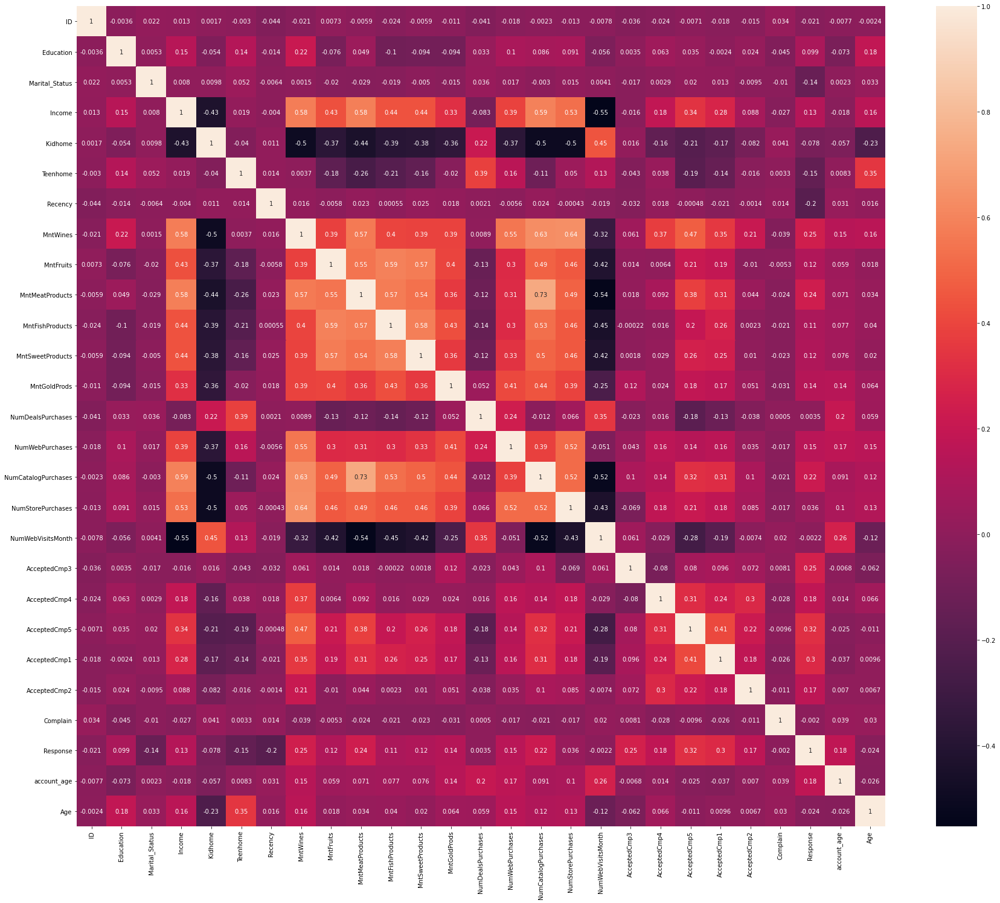

In [54]:
plt.figure(figsize=(30,25))
sns.heatmap(df.corr(), annot=True)

Setelah melihat analisis data di atas, akan dilihat kembali apakah data sudah bagus dengan profiling report

In [25]:
report = df.profile_report(title='Marketing Campaign - Report',
                             progress_bar=False)
report

Berdasarkan analisis report di atas setelah dilakukan perubahan data oulier, 
maka data sebaran target market yang memiliki korelasi yang tinggi terhadap kemauan menerima campaian ataupun acceptedCmp 4 hanya ketiga features tersebut di atas, sementara feature lainnya seperti education, marital status, usia
memberikan korelasi yang rendah
sementara itu faeture seperti pembelian produk baik daging, wine, buah, dll tidak dimasukkan

# Proses Classification

In [45]:
print('Data Featute yang digunakan untuk case ini adalah:')
print('1. Income')
print('2. Kidhome')
print('3. Teenhome')

Data Featute yang digunakan untuk case ini adalah:
1. Income
2. Kidhome
3. Teenhome


data feature yang digunakan untuk model ini adalah income, kidhome, dan teenhome untuk memprediksi apakah pasar sasaran menerima campaign yang dilakukan

In [84]:
# Pilih data feature yang diinginkan
# Target yang dituju adalah Attrition Flag

data_features = df[['Income','Kidhome','Teenhome']].values
data_target   = df[['AcceptedCmp4']].values


#Memilih data train dan data test, dengan perbandingan data test sebesar 20% dari data asli, dan sisanya sebagai data train
x_train,x_test,y_train,y_test = train_test_split(data_features,data_target,test_size=0.20)
y_test = y_test.reshape(len(y_test))
y_train = y_train.reshape(len(y_train))
print('shape feature total: ', data_features.shape)
print('shape feature train: ', x_train.shape)
print('shape feature test: ', x_test.shape)
print('shape target test: ', y_test.shape)

shape feature total:  (2216, 3)
shape feature train:  (1772, 3)
shape feature test:  (444, 3)
shape target test:  (444,)


# Logistic Regression 

In [86]:
# Fitting Model
model_LR               = LogisticRegression().fit(x_train,y_train)

# Prediksi data train dengan model
y_pred_train_LR        = model_LR.predict(x_train)

# Prediksi data test dengan model
y_pred_test_LR         = model_LR.predict(x_test)

# Performance data train
score_train_LR         = model_LR.score(x_train,y_train)
print('Performance Model Data Train LR = ', score_train_LR)

# Performance data test
score_test_LR          = model_LR.score(x_test,y_test)
print('Performance Model Data Test LR = ', score_test_LR)

#Confusion matrix data train
print('')
print('Confusion Matrix Data Train:')
print('---------------------------')
print('')
conf_matrix_train_LR   = confusion_matrix(y_train, y_pred_train_LR)
print(conf_matrix_train_LR)


#Confusion matrix data test
print('')
print('Confusion Matrix Data Test:')
print('---------------------------')
conf_matrix_test_LR    = confusion_matrix(y_test, y_pred_test_LR)
print(conf_matrix_test_LR)

Performance Model Data Train LR =  0.9238148984198645
Performance Model Data Test LR =  0.9346846846846847

Confusion Matrix Data Train:
---------------------------

[[1637    0]
 [ 135    0]]

Confusion Matrix Data Test:
---------------------------
[[415   0]
 [ 29   0]]


Sehubungan performance model menggunakan logistik regression hanya 92% baik untuk data train dan 93% untuk test maka, model menggunakan LR di hold untuk dipilih, dan akan menunggu cara modelling yang lain


Plot Confusion Matrix Data Test:
--------------------------------


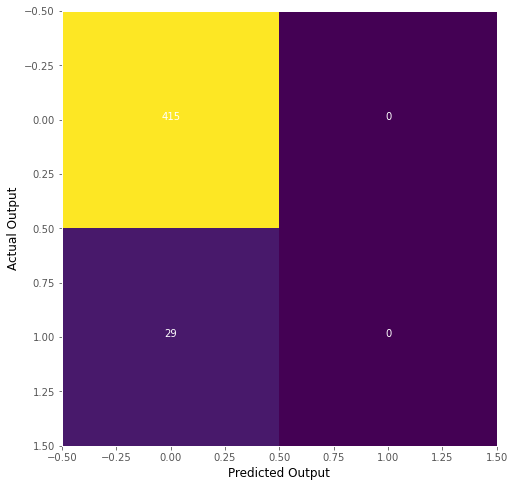

In [87]:
# Plot Confusion Matrix untuk Data Test
print('')
print('Plot Confusion Matrix Data Test:')
print('--------------------------------')
mpl.style.use(['ggplot'])
fig,ax = plt.subplots(figsize=(8,8))
ax.imshow (conf_matrix_test_LR)
ax.grid(False)
ax.set_xlabel('Predicted Output', color='black')
ax.set_ylabel('Actual Output', color='black')
for i in range (len(conf_matrix_test_LR[0])):
    for j in range (len(conf_matrix_test_LR[0])):
        ax.text(j,i,conf_matrix_test_LR[i,j],ha='center',color='white')
plt.show()

Matrix confusion yang terbentuk terdiri dari empat bagian. Dimana:

kiri atas: banyaknya data test yang actualnya bernilai 0 dan hasil prediksinya juga 0

kiri bawah: banyaknya data test yang actualnya bernilai 1 tetapi hasil prediksinya 0

kanan atas: banyaknya data test yang actualnya bernilai 0 tetapi hasil prediksinya 1

kanan bawah: banyaknya data test yang actualnya bernilai 1 dan hasil prediksinya juga 1

# Model KNN

In [89]:
model_KNN              = KNeighborsClassifier().fit(x_train,y_train)

y_pred_train_KNN       = model_KNN.predict(x_train)

y_pred_test_KNN        = model_KNN.predict(x_test)

score_train_KNN        = model_KNN.score(x_train,y_train)
print('Performance Model Data Train KNN = ', score_train_KNN)

score_test_KNN         = model_KNN.score(x_test,y_test)
print('Performance Model Data Test KNN = ', score_test_KNN)

print('')
print('Confusion Matrix Data Train:')
print('---------------------------')
print('')
conf_matrix_train_KNN  = confusion_matrix(y_train, y_pred_train_KNN)
print(conf_matrix_train_KNN)

print('')
print('Confusion Matrix Data Test:')
print('---------------------------')
print('')

conf_matrix_test_KNN   = confusion_matrix(y_test, y_pred_test_KNN)
print(conf_matrix_test_KNN)

Performance Model Data Train KNN =  0.927765237020316
Performance Model Data Test KNN =  0.918918918918919

Confusion Matrix Data Train:
---------------------------

[[1626   11]
 [ 117   18]]

Confusion Matrix Data Test:
---------------------------

[[404  11]
 [ 25   4]]


Sehubungan performance model menggunakan KNN  92% baik untuk data train dan 93% untuk test maka, model menggunakan KNN di hold untuk dipilih, dan akan menunggu cara modelling yang lain



Plot Confusion Matrix Data Test:
--------------------------------


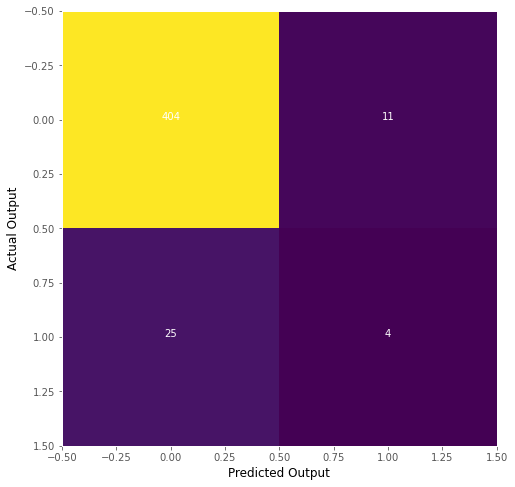

In [90]:
print('')
print('Plot Confusion Matrix Data Test:')
print('--------------------------------')

mpl.style.use(['ggplot'])
fig,ax = plt.subplots(figsize=(8,8))
ax.imshow (conf_matrix_test_KNN)
ax.grid(False)
ax.set_xlabel('Predicted Output', color='black')
ax.set_ylabel('Actual Output', color='black')
for i in range (len(conf_matrix_test_KNN[0])):
    for j in range (len(conf_matrix_test_KNN[0])):
        ax.text(j,i,conf_matrix_test_KNN[i,j],ha='center',color='white')
plt.show()

# Gaussian

In [91]:
model_GNB       = GaussianNB().fit(x_train,y_train)

y_pred_train_GNB       = model_GNB.predict(x_train)

y_pred_test_GNB        = model_GNB.predict(x_test)

score_train_GNB        = model_GNB.score(x_train,y_train)
print('Performance Model Data Train GNB = ', score_train_GNB)

score_test_GNB         = model_GNB.score(x_test,y_test)
print('Performance Model Data Test GNB = ', score_test_GNB)


print('')
print('Confusion Matrix Data Train:')
print('---------------------------')
print('')
conf_matrix_train_GNB  = confusion_matrix(y_train, y_pred_train_GNB)
print(conf_matrix_train_GNB)


print('')
print('Confusion Matrix Data Test:')
print('---------------------------')
print('')
conf_matrix_test_GNB   = confusion_matrix(y_test, y_pred_test_GNB)
print(conf_matrix_test_GNB)

Performance Model Data Train GNB =  0.9238148984198645
Performance Model Data Test GNB =  0.9346846846846847

Confusion Matrix Data Train:
---------------------------

[[1637    0]
 [ 135    0]]

Confusion Matrix Data Test:
---------------------------

[[415   0]
 [ 29   0]]


Sehubungan performance model menggunakan GNB 92% baik untuk data train dan 93% test maka, model menggunakan Gaussian di hold untuk dipilih, dan akan menunggu cara modelling yang lain


Plot Confusion Matrix Data Test:
--------------------------------


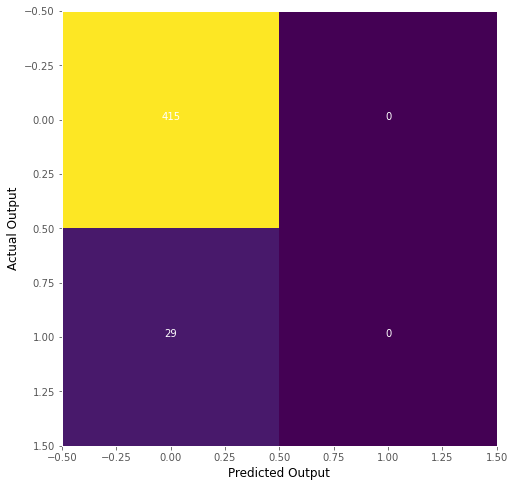

In [93]:
print('')
print('Plot Confusion Matrix Data Test:')
print('--------------------------------')


mpl.style.use(['ggplot'])
fig,ax = plt.subplots(figsize=(8,8))
ax.imshow (conf_matrix_test_GNB)
ax.grid(False)
ax.set_xlabel('Predicted Output', color='black')
ax.set_ylabel('Actual Output', color='black')
for i in range (len(conf_matrix_test_GNB[0])):
    for j in range (len(conf_matrix_test_GNB[0])):
        ax.text(j,i,conf_matrix_test_GNB[i,j],ha='center',color='white')
plt.show()

# Desician Tree

In [92]:
model_DT              = DecisionTreeClassifier().fit(x_train,y_train)

y_pred_train_DT       = model_DT.predict(x_train)

y_pred_test_DT        = model_DT.predict(x_test)

score_train_DT        = model_DT.score(x_train,y_train)
print('Performance Model Data Train DT = ', score_train_DT)

score_test_DT         = model_DT.score(x_test,y_test)
print('Performance Model Data Test DT = ', score_test_DT)

print('')
print('Confusion Matrix Data Train:')
print('---------------------------')
print('')
conf_matrix_train_DT  = confusion_matrix(y_train, y_pred_train_DT)
print(conf_matrix_train_DT)

print('')
print('Confusion Matrix Data Test:')
print('---------------------------')
print('')
conf_matrix_test_DT   = confusion_matrix(y_test, y_pred_test_DT)
print(conf_matrix_test_DT)

Performance Model Data Train DT =  1.0
Performance Model Data Test DT =  0.8963963963963963

Confusion Matrix Data Train:
---------------------------

[[1637    0]
 [   0  135]]

Confusion Matrix Data Test:
---------------------------

[[389  26]
 [ 20   9]]



Plot Confusion Matrix Data Test:
--------------------------------


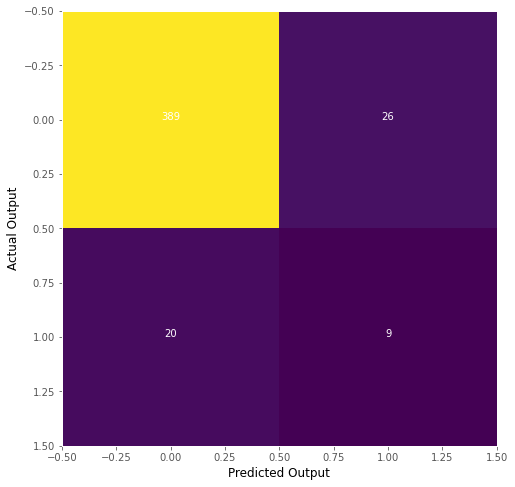

In [94]:
print('')
print('Plot Confusion Matrix Data Test:')
print('--------------------------------')

mpl.style.use(['ggplot'])
fig,ax = plt.subplots(figsize=(8,8))
ax.imshow (conf_matrix_test_DT)
ax.grid(False)
ax.set_xlabel('Predicted Output', color='black')
ax.set_ylabel('Actual Output', color='black')
for i in range (len(conf_matrix_test_DT[0])):
    for j in range (len(conf_matrix_test_DT[0])):
        ax.text(j,i,conf_matrix_test_DT[i,j],ha='center',color='white')
plt.show()

# Random Forest

In [95]:
model_RF              = RandomForestClassifier().fit(x_train,y_train)

y_pred_train_RF       = model_RF.predict(x_train)

y_pred_test_RF        = model_RF.predict(x_test)

score_train_RF        = model_RF.score(x_train,y_train)
print('Performance Model Data Train RF = ', score_train_RF)

score_test_RF         = model_RF.score(x_test,y_test)
print('Performance Model Data Test RF = ', score_test_RF)

print('')
print('Confusion Matrix Data Train:')
print('---------------------------')
print('')
conf_matrix_train_RF  = confusion_matrix(y_train, y_pred_train_RF)
print(conf_matrix_train_RF)

print('')
print('Confusion Matrix Data Test:')
print('---------------------------')
print('')
conf_matrix_test_RF   = confusion_matrix(y_test, y_pred_test_RF)
print(conf_matrix_test_RF)

Performance Model Data Train RF =  1.0
Performance Model Data Test RF =  0.9076576576576577

Confusion Matrix Data Train:
---------------------------

[[1637    0]
 [   0  135]]

Confusion Matrix Data Test:
---------------------------

[[393  22]
 [ 19  10]]


Sehubungan performance model menggunakan RF hanya 100% untuk data train namun sudah mencapai 90% test maka, model menggunakan RF untuk sementara di hold, dan dilihat dulu menggunakan cara modelling yang lain


Plot Confusion Matrix Data Test:
--------------------------------


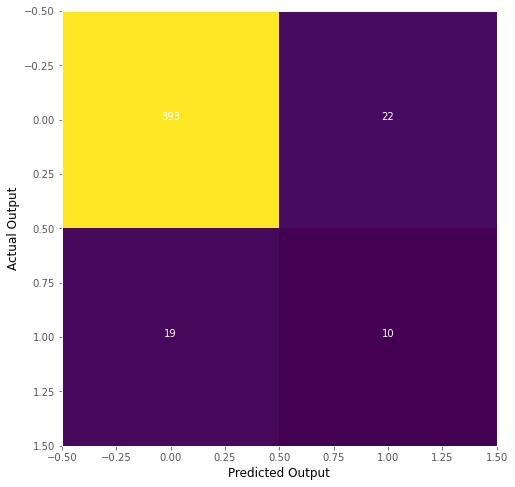

In [96]:
print('')
print('Plot Confusion Matrix Data Test:')
print('--------------------------------')


mpl.style.use(['ggplot'])
fig,ax = plt.subplots(figsize=(8,8))
ax.imshow (conf_matrix_test_RF)
ax.grid(False)
ax.set_xlabel('Predicted Output', color='black')
ax.set_ylabel('Actual Output', color='black')
for i in range (len(conf_matrix_test_RF[0])):
    for j in range (len(conf_matrix_test_RF[0])):
        ax.text(j,i,conf_matrix_test_RF[i,j],ha='center',color='white')
plt.show()

# SVM

In [97]:
model_SVM              = svm.SVC().fit(x_train,y_train)

y_pred_train_SVM       = model_SVM.predict(x_train)

y_pred_test_SVM        = model_SVM.predict(x_test)

score_train_SVM        = model_SVM.score(x_train,y_train)
print('Performance Model Data Train SVM = ', score_train_SVM)

score_test_SVM         = model_SVM.score(x_test,y_test)
print('Performance Model Data Test SVM = ', score_test_SVM)


print('')
print('Confusion Matrix Data Train:')
print('---------------------------')
print('')
conf_matrix_train_SVM  = confusion_matrix(y_train, y_pred_train_SVM)
print(conf_matrix_train_SVM)

print('')
print('Confusion Matrix Data Test:')
print('---------------------------')
print('')
conf_matrix_test_SVM   = confusion_matrix(y_test, y_pred_test_SVM)
print(conf_matrix_test_SVM)

Performance Model Data Train SVM =  0.9238148984198645
Performance Model Data Test SVM =  0.9346846846846847

Confusion Matrix Data Train:
---------------------------

[[1637    0]
 [ 135    0]]

Confusion Matrix Data Test:
---------------------------

[[415   0]
 [ 29   0]]


Sehubungan performance model menggunakan SVM  92% untuk data train namun sudah mencapai 93% test maka, model menggunakan RF untuk sementara di hold, dan dilihat dulu menggunakan cara modelling yang lain



Plot Confusion Matrix Data Test:
--------------------------------


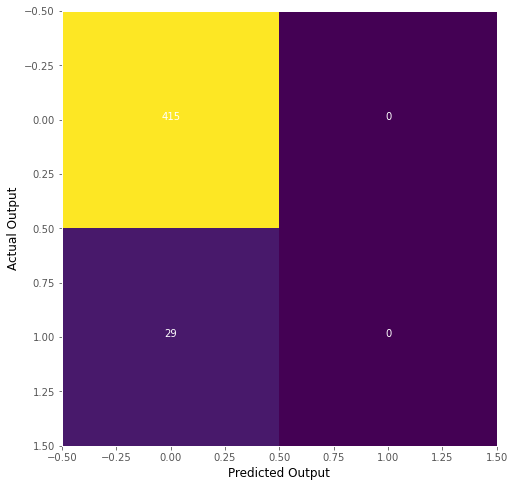

In [99]:
print('')
print('Plot Confusion Matrix Data Test:')
print('--------------------------------')


mpl.style.use(['ggplot'])
fig,ax = plt.subplots(figsize=(8,8))
ax.imshow (conf_matrix_test_SVM)
ax.grid(False)
ax.set_xlabel('Predicted Output', color='black')
ax.set_ylabel('Actual Output', color='black')
for i in range (len(conf_matrix_test_SVM[0])):
    for j in range (len(conf_matrix_test_SVM[0])):
        ax.text(j,i,conf_matrix_test_SVM[i,j],ha='center',color='white')
plt.show()

In [122]:
print('Hasil Score 6 Model Classification')
print('-----------------------------------')


rekap_score = {'Model':['Logistic Regression','KNN','Naive Bayes', 'Decision Tree', 'Random Forest', 'SVM'], 
        'Score Data Train':[score_train_LR, score_train_KNN, score_train_GNB, score_train_DT, score_train_RF, score_train_SVM],'Score Data Test':[score_test_LR, score_test_KNN, score_test_GNB, score_test_DT, score_test_RF, score_test_SVM]} 
output_rekap_score = pd.DataFrame(rekap_score)
output_rekap_score

Hasil Score 6 Model Classification
-----------------------------------


,Model,Score Data Train,Score Data Test
0,Logistic Regression,0.923815,0.934685
1,KNN,0.927765,0.918919
2,Naive Bayes,0.923815,0.934685
3,Decision Tree,1.000000,0.896396
4,Random Forest,1.000000,0.907658
5,SVM,0.923815,0.934685


keterangan:sehubungan model LR, NB, SVM  memiliki perfomance train yang hampir sama dengan hasil testnya maka yang diambil adalah model ini (LR) dibandingkan model lain DT dan RF yang data trainnya 100% (too good to be true) tapi data testnya hanya 89-90%.

AcceptedCmp4 = 0 berarti Tidak menerima campaign
AcceptedCmp4 = 1 berarti menerima campaign



In [101]:
import pickle
pickle.dump(model_LR,open('./model_classificationFP.pkl','wb'))
model = pickle.load(open('./model_classificationFP.pkl','rb'))

dari model dapat dilakukan prediksi imputan apakah target konsumer akan menerima campaign atau tidak, seperti cintoh di bawah ini

In [120]:
Income = 50000
Kidhome = 0
Teenhome = 1
print('1. Income =', Income)
print('2. Kidhome =', Kidhome)
print('3. Teenhome =', Teenhome)
data_input = np.array([Income, Kidhome, Teenhome]).reshape(1,-1)
#data_input = np.array([Income, Kidhome, Teenhome])
print('Shape Data Input',data_input.shape)
print('---------------------------------')
prediksi = model.predict(data_input)
print('Hasil Prediksi: ', prediksi)
print('---------------------------------')
if prediksi == 0:
    print("AcceptedCmp4: Tidak Terima Campaign")
else:
    print("AcceptedCmp4: Terima campaign")

1. Income = 50000
2. Kidhome = 0
3. Teenhome = 1
Shape Data Input (1, 3)
---------------------------------
Hasil Prediksi:  [0]
---------------------------------
AcceptedCmp4: Tidak Terima Campaign
